In [1]:
# pip install -U numpy==1.18.5

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import load_model
import numpy.ma as ma
from matplotlib.pyplot import figure
import h5py
plt.rcParams["figure.figsize"] = (20,12)
figure(figsize=(100, 80), dpi=80)

<Figure size 8000x6400 with 0 Axes>

<Figure size 8000x6400 with 0 Axes>

In [3]:
f = h5py.File("plazamont_processed_data.h5","r")
scaled_X = ma.array(f["scaled_x"])
scaled_X.mask = ma.array(f["x_mask"])
minX = np.array(f["minX"])
maxX = np.array(f["maxX"])
f.close()

In [4]:
with open('train_performance.npy', 'rb') as f:
    train_performance = np.load(f, allow_pickle=True)

In [5]:
with open('val_performance.npy', 'rb') as f:
    val_performance = np.load(f, allow_pickle=True)

In [6]:
with open('train_X_data.npy', 'rb') as f:
    train_X_data = np.load(f, allow_pickle=True)

In [7]:
with open('train_Y_data.npy', 'rb') as f:
    train_Y_data = np.load(f, allow_pickle=True)

In [8]:
with open('test_X_data.npy', 'rb') as f:
    test_X_data = np.load(f, allow_pickle=True)

In [9]:
with open('test_Y_data.npy', 'rb') as f:
    test_Y_data = np.load(f, allow_pickle=True)

In [10]:
models = []

In [11]:
[models.append(load_model('/home/costa/JoaoModelsForAlicante/PzaMont/models/PzaMontModel'+str(i)+'.h5')) for i in range(0,74)]

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [12]:
import os

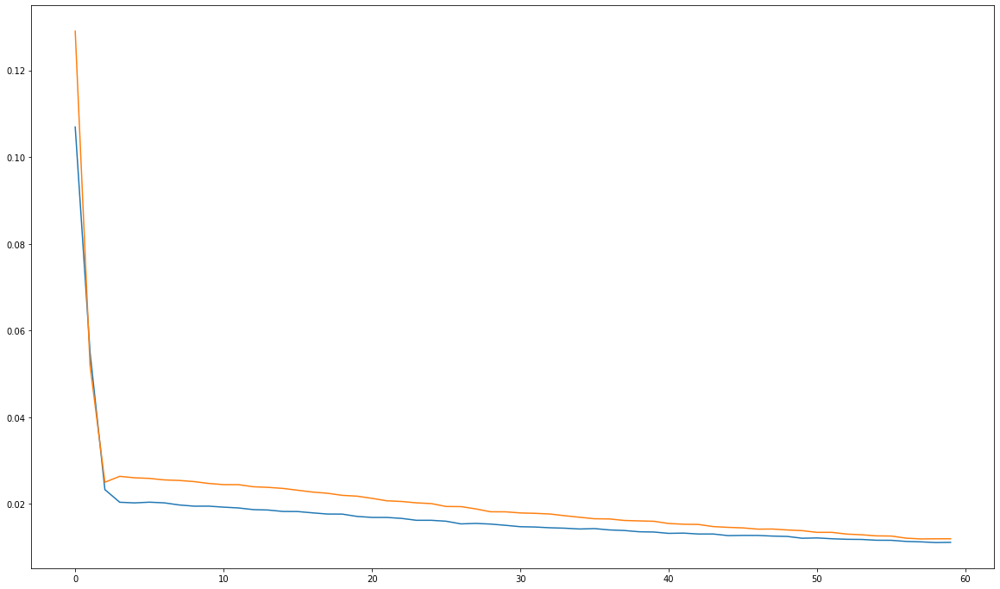

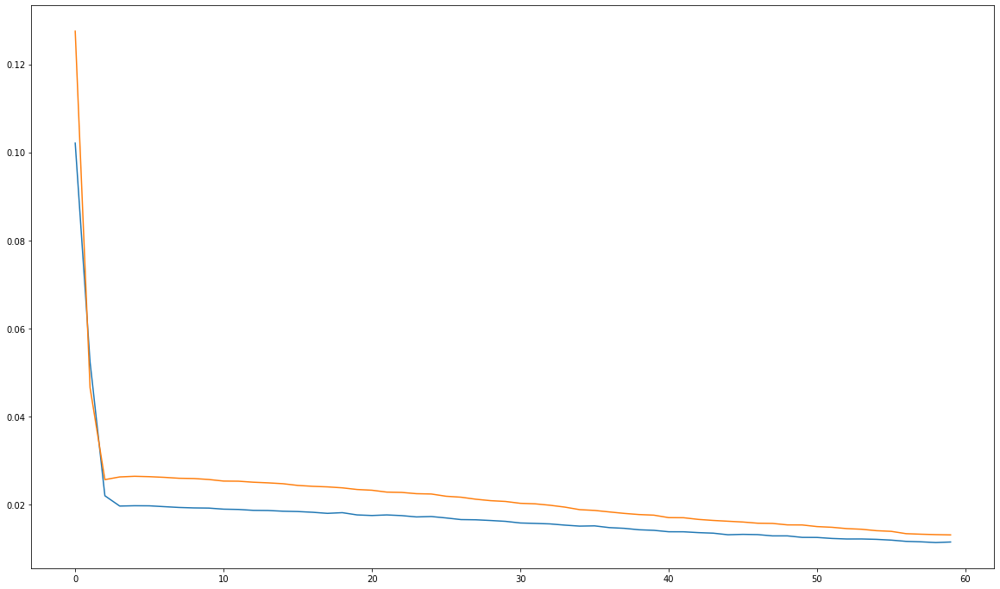

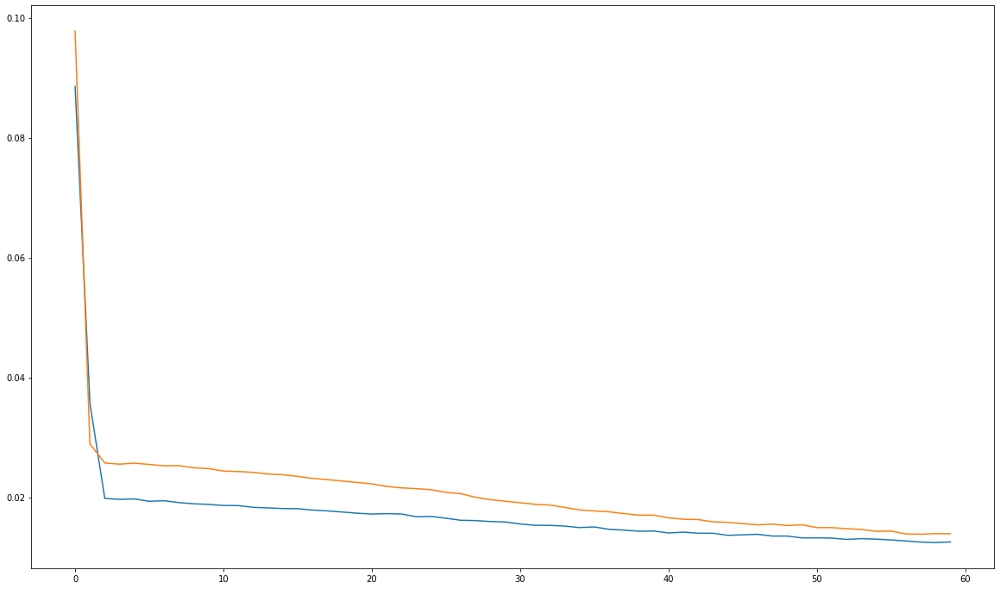

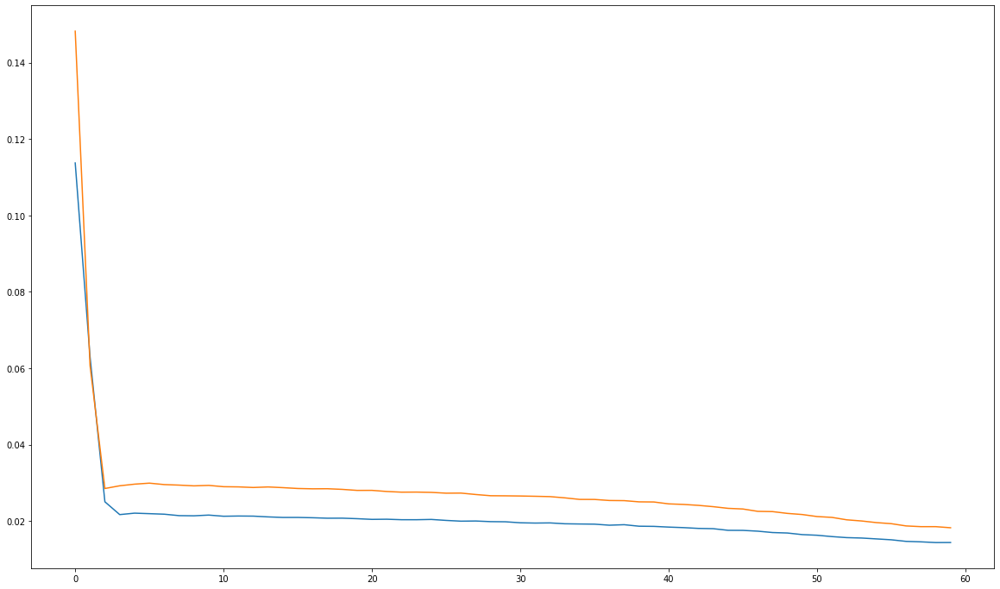

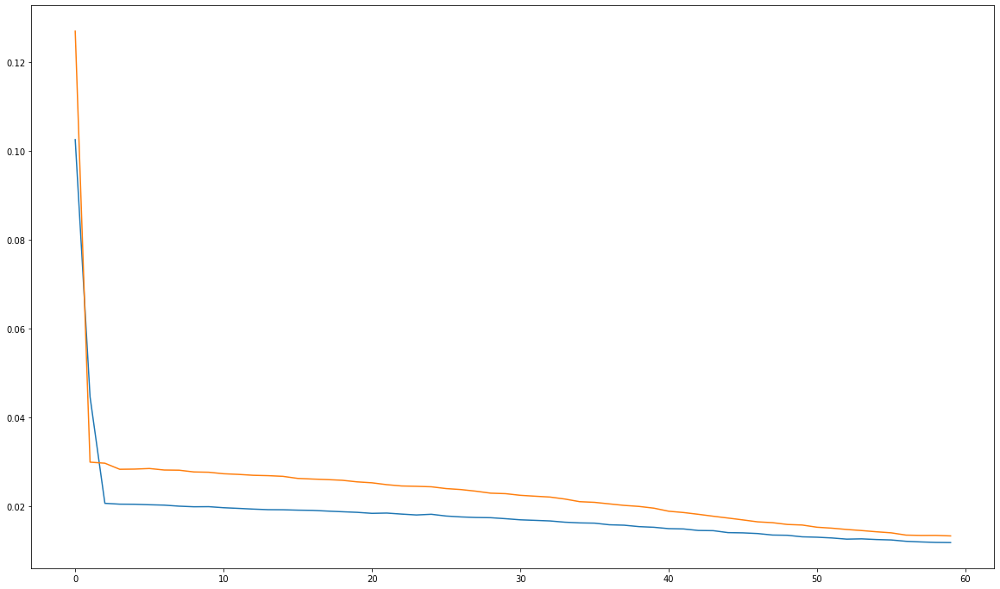

...

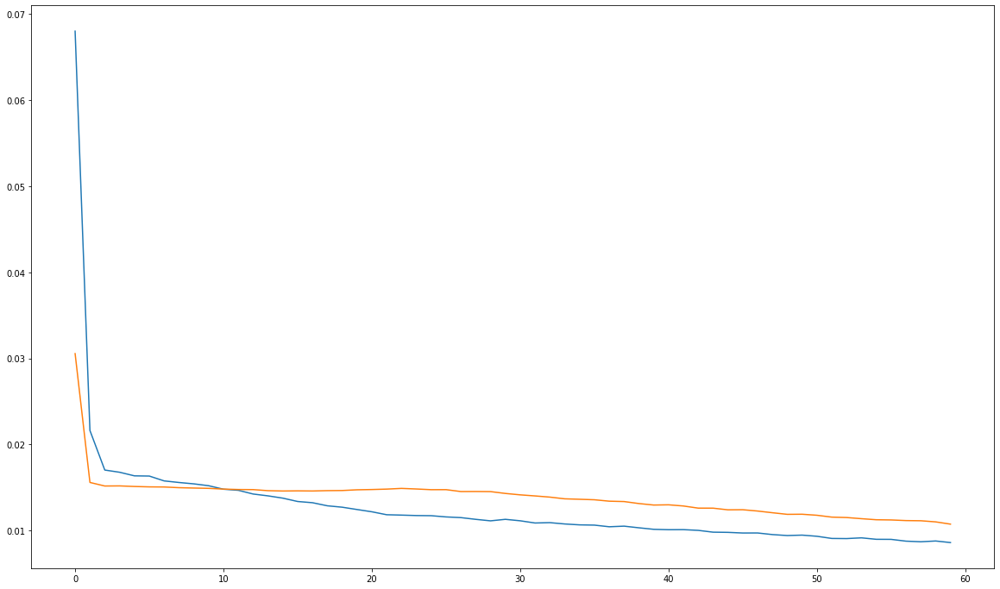

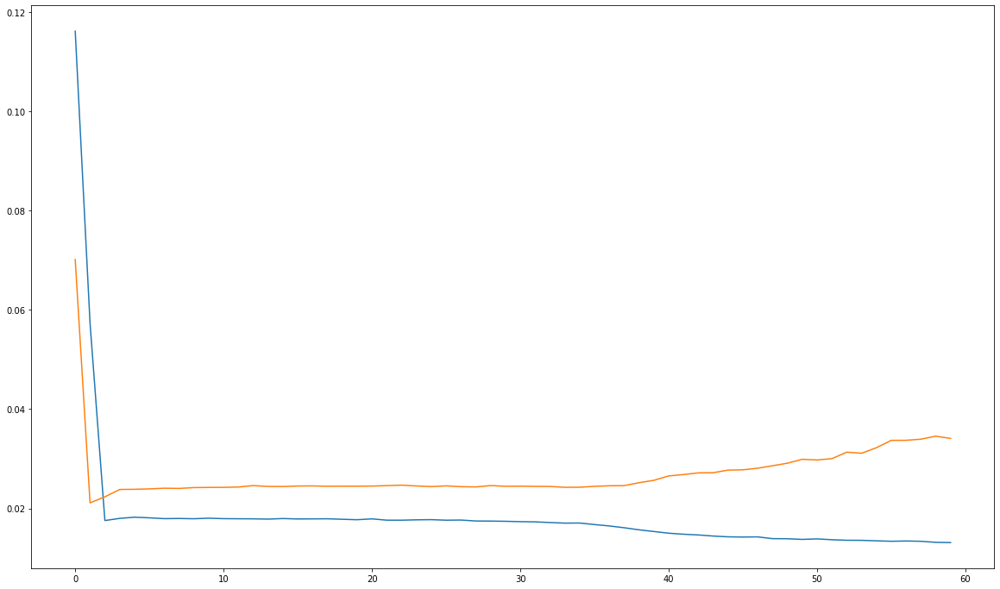

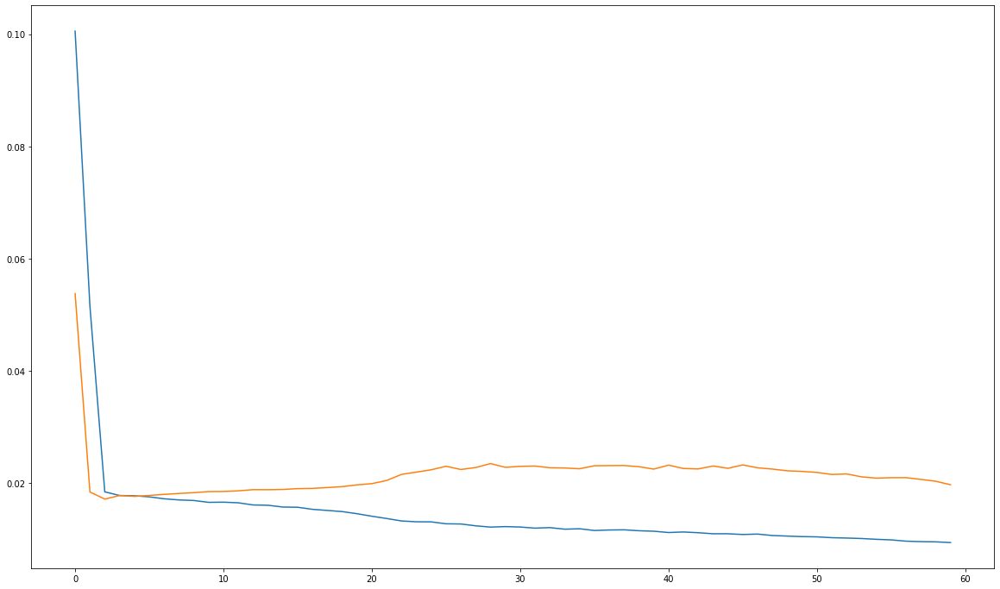

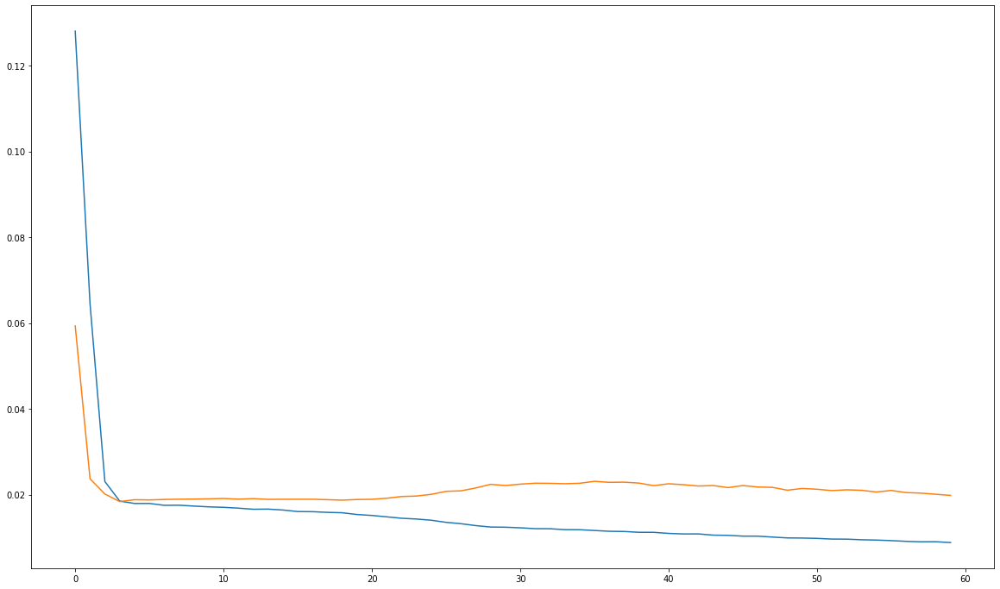

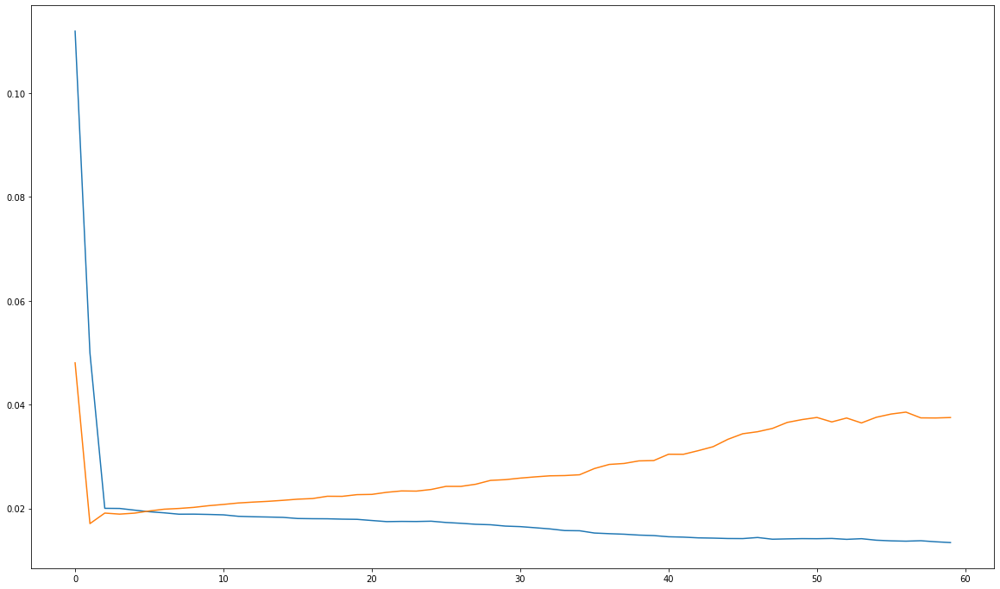

In [13]:
for i in range(0,len(train_performance)):
    plt.plot(train_performance[i])
    plt.plot(val_performance[i])
    path = "/home/costa/JoaoModelsForAlicante/PzaMont/PzaMontPerformance"
    plt.savefig(os.path.join(path, "ModelPerformance"+str(i)+".jpg"))
    plt.show()

In [14]:
X_train = []
X_test = []
Y_train = []
Y_test = []

In [15]:
train_X = [ma.masked_invalid(train_X_data[i][:,0]) for i in range(0, len(train_X_data))]
X_train = np.vstack(train_X)
X_train[X_train==0]=ma.masked
# x_train_null = []
# for i in range(0, len(test_X_data)):
#     x_train_null.append(np.vstack(np.where(train_X_data[i][:,0] == 0.0)[0][:]))

In [16]:
test_X = [ma.masked_invalid(test_X_data[i][:,0]) for i in range(0, len(test_X_data))]
X_test = np.stack(test_X)
X_test[X_test==0]=ma.masked
# x_test_null = []
# for i in range(0, len(test_X_data)):
#     x_test_null.append(np.vstack(np.where(test_X_data[i][:,0] == 0.0)))

In [17]:
train_Y = [ma.masked_invalid(train_Y_data[i][:,0]) for i in range(0, len(train_Y_data))]
Y_train = np.stack(train_Y)
Y_train[Y_train==0]=ma.masked
# y_train_null = []
# for i in range(0, len(train_Y_data)):
#     y_train_null.append(np.vstack(np.where(train_Y_data[i][:,0] == 0.0)[0][:]))

In [18]:
test_Y = [ma.masked_invalid(test_Y_data[i][:,0]) for i in range(0, len(test_Y_data))]
Y_test = np.stack(test_Y)
Y_test[Y_test==0]=ma.masked
# y_test_null = []
# for i in range(0, len(test_Y_data)):
#     y_test_null.append(np.vstack(np.where(test_Y_data[i][:,0] == 0.0)[:]))

In [19]:
def inverse_scaler(data, mindata, maxdata):
    return data*maxdata-mindata

In [20]:
# Prediction on Test Set
def prediction_test(model):
    prediction_test = model.predict(test_X_data[i])
    return prediction_test

test_predictions = []

for i in range(0, 74):
    test_predictions.append(prediction_test(models[i]))

In [21]:
# Prediction on Train Set
def prediction_train(model):
    prediction_train = model.predict(train_X_data[i])
    return prediction_train

train_predictions = []

for i in range(0, 74):
    train_predictions.append(prediction_train(models[i]))

In [22]:
train_pred = [ma.masked_invalid(train_predictions[i]) for i in range(0, len(train_predictions))]
pred_train = np.stack(train_pred)

for i in range(0, len(Y_train)):
    pred_train[i, [np.where(train_Y_data[i][:,0] == 0.0)[0]], :] = ma.masked

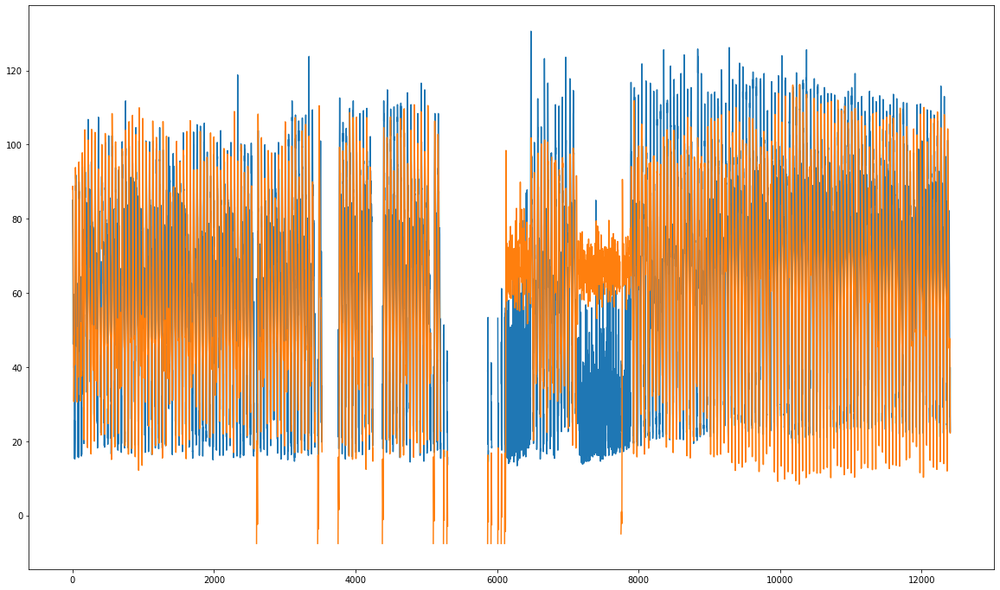

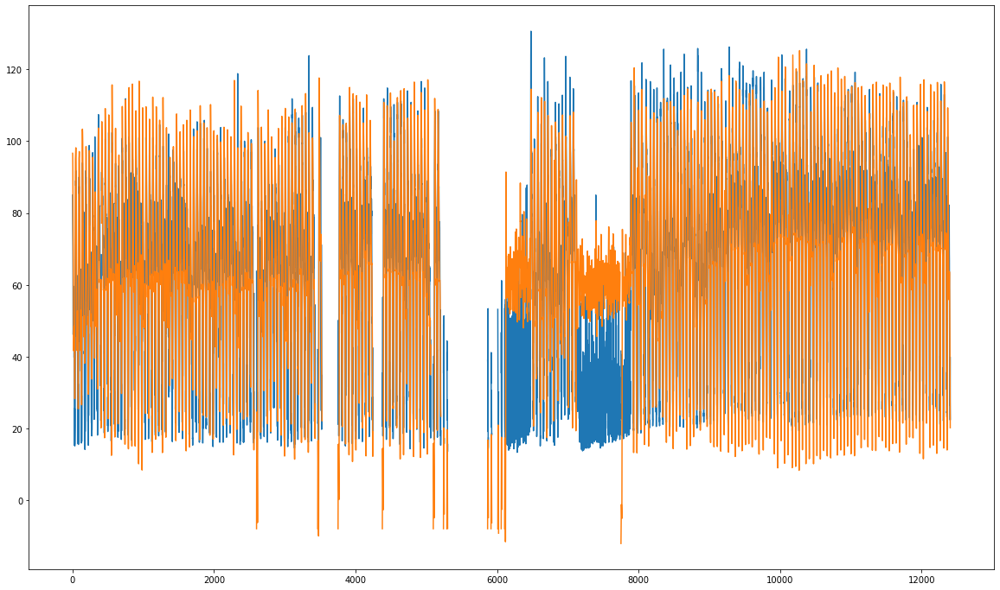

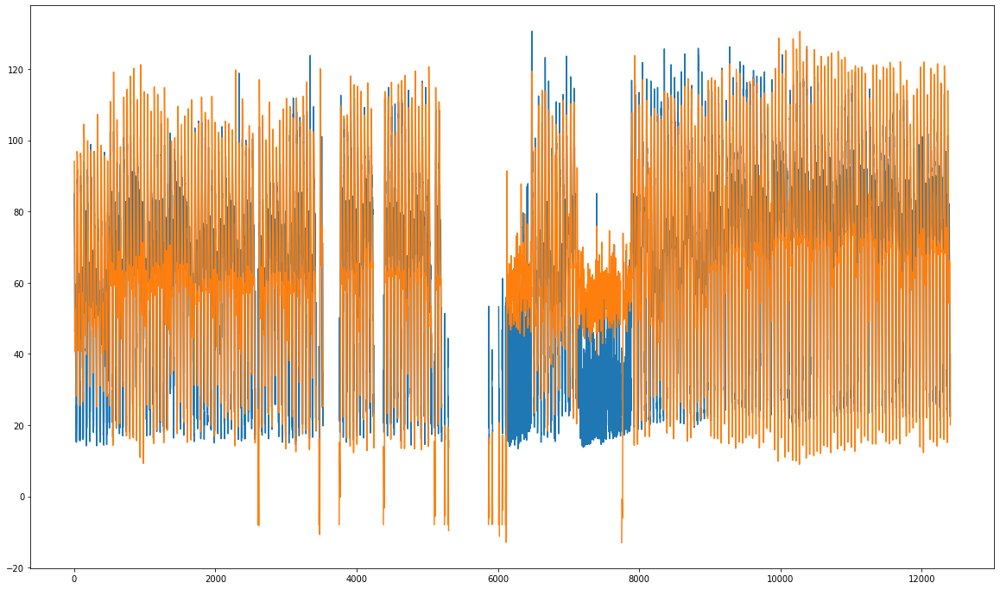

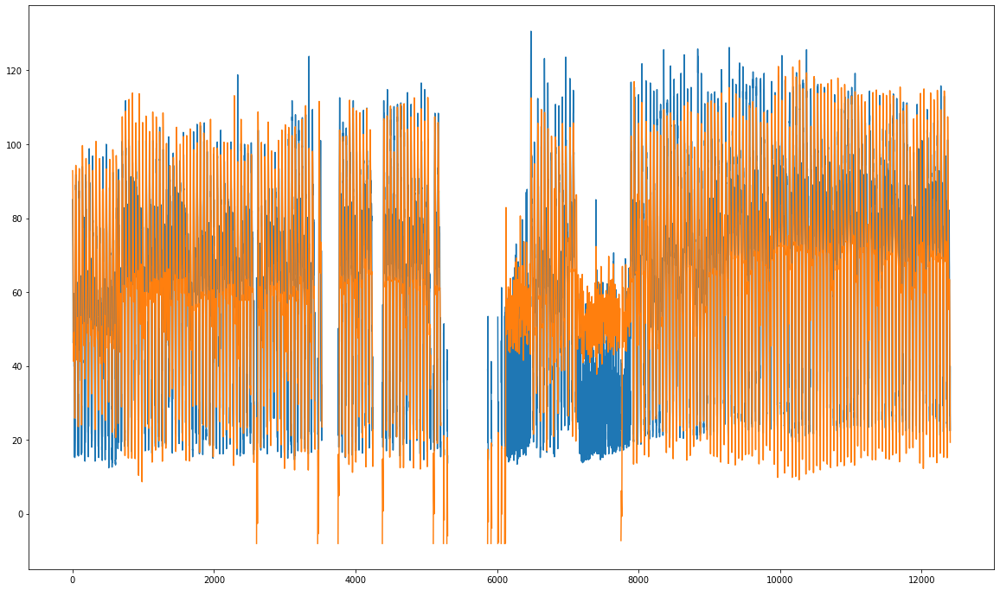

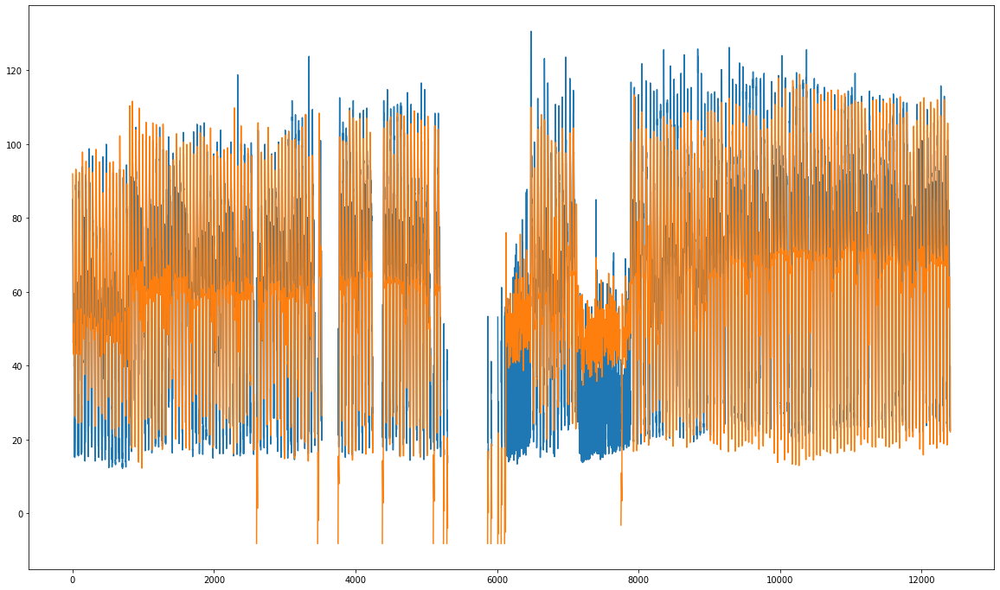

...

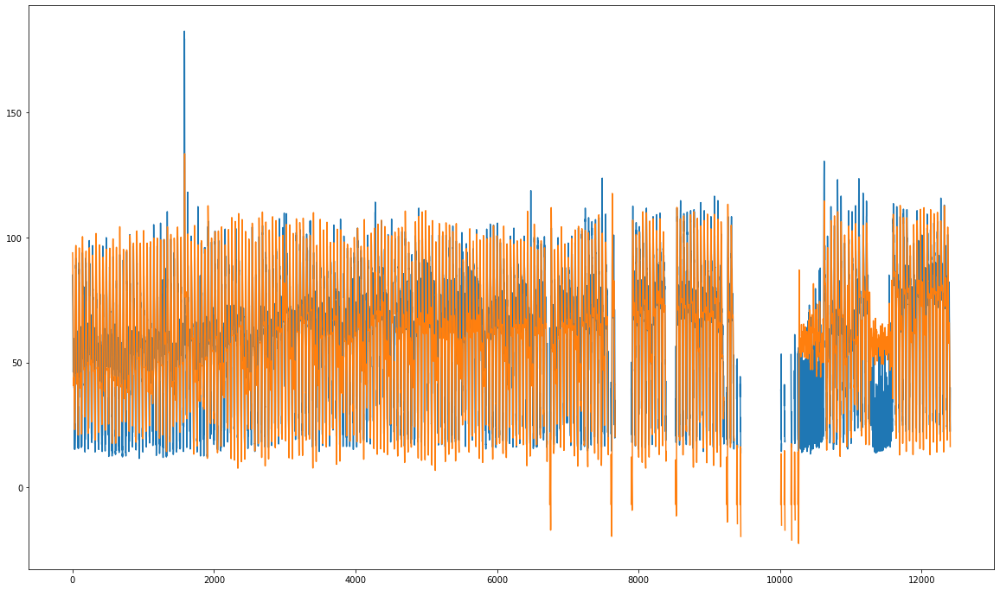

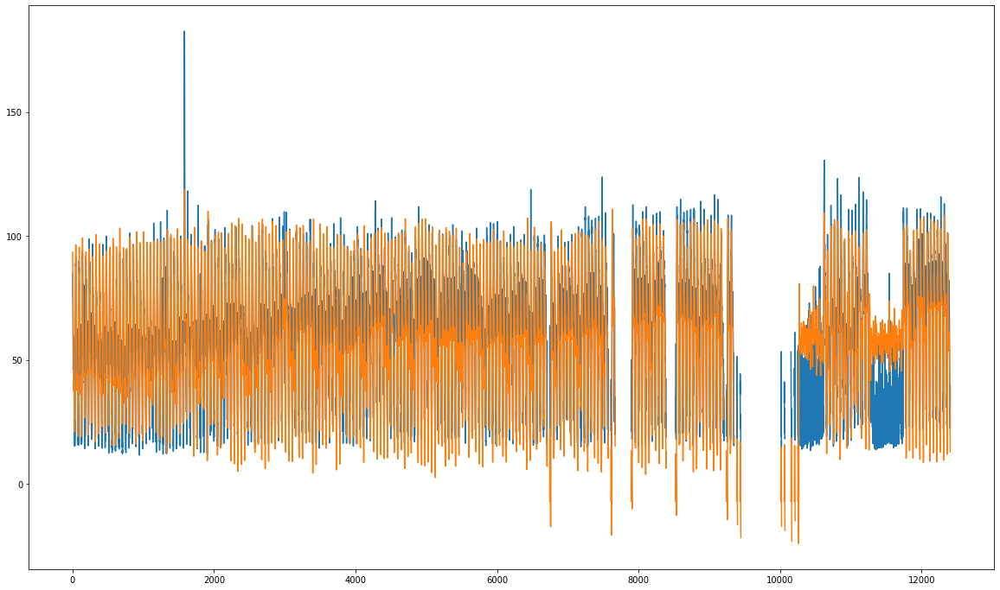

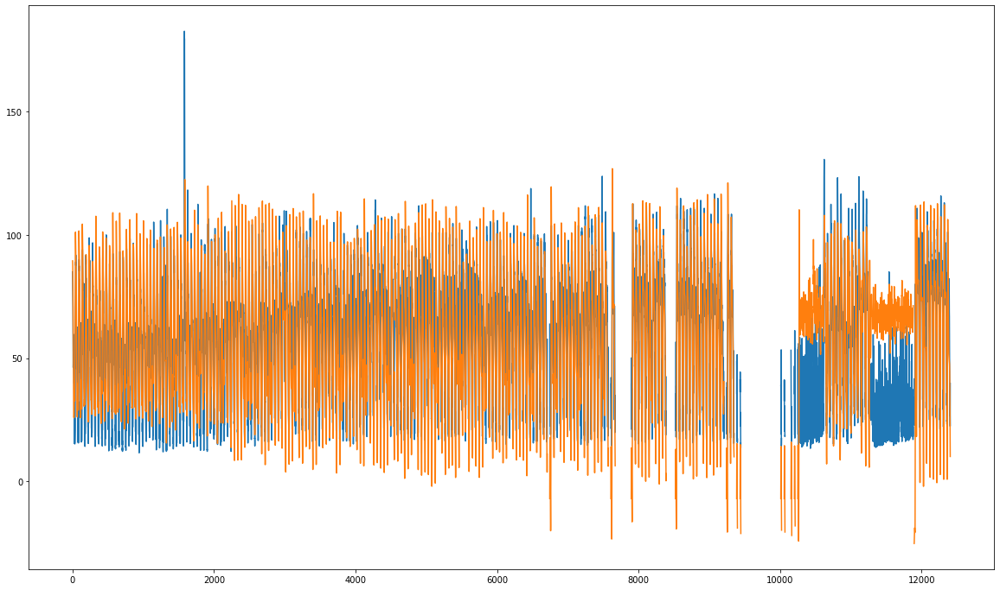

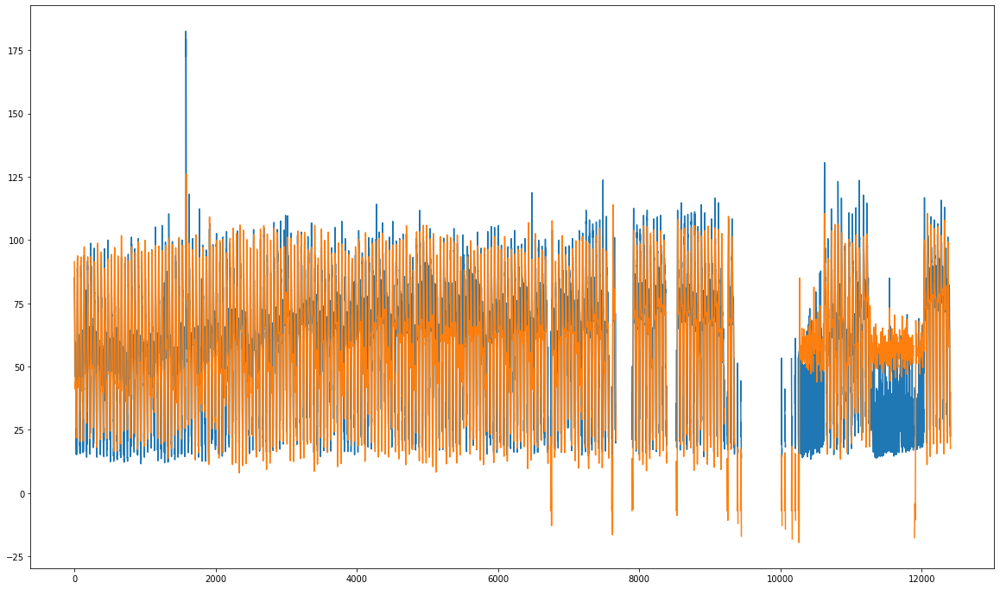

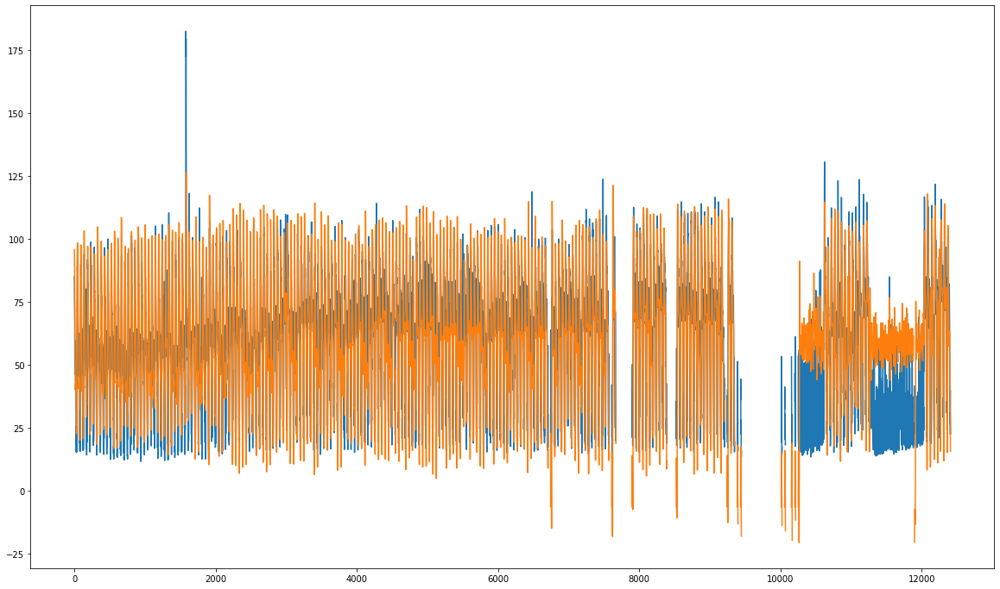

In [23]:
for i in range(0,len(train_Y_data)):
    plt.plot(inverse_scaler(Y_train[i], minX, maxX))
    plt.plot(inverse_scaler(pred_train[i][:,0], minX, maxX))
    path = "/home/costa/JoaoModelsForAlicante/PzaMont/PzaMontTrainPredictions"
    plt.savefig(os.path.join(path, "PzaMontTrainPrediction"+str(i)+".jpg"))
    plt.show()

In [24]:
test_pred = [ma.masked_invalid(test_predictions[i]) for i in range(0, len(test_predictions))]
pred_test = np.stack(test_pred)

for i in range(0, len(Y_test)):
    pred_test[i, [np.where(test_Y_data[i][:,0] == 0.0)[0]], :] = ma.masked

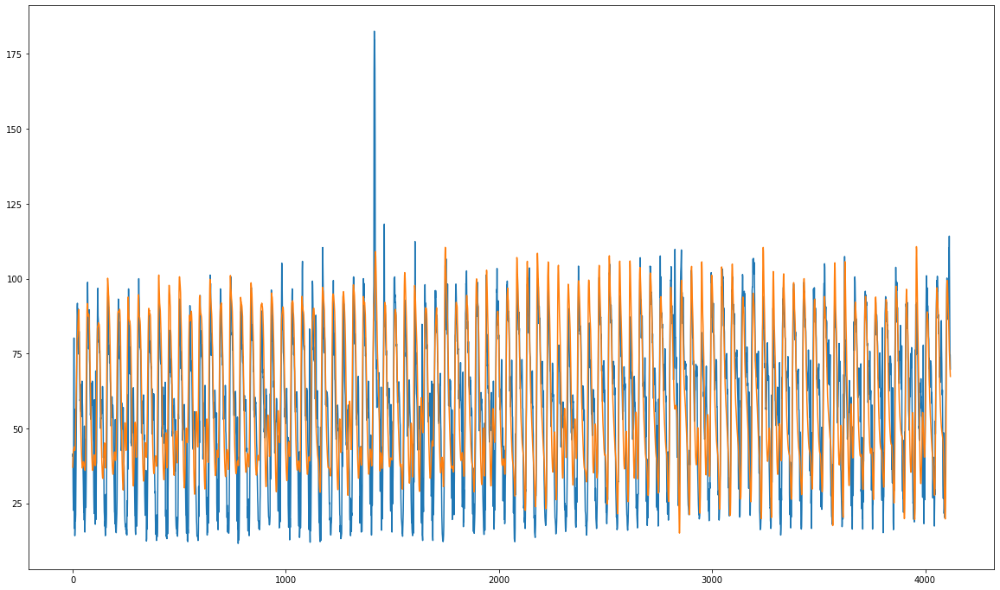

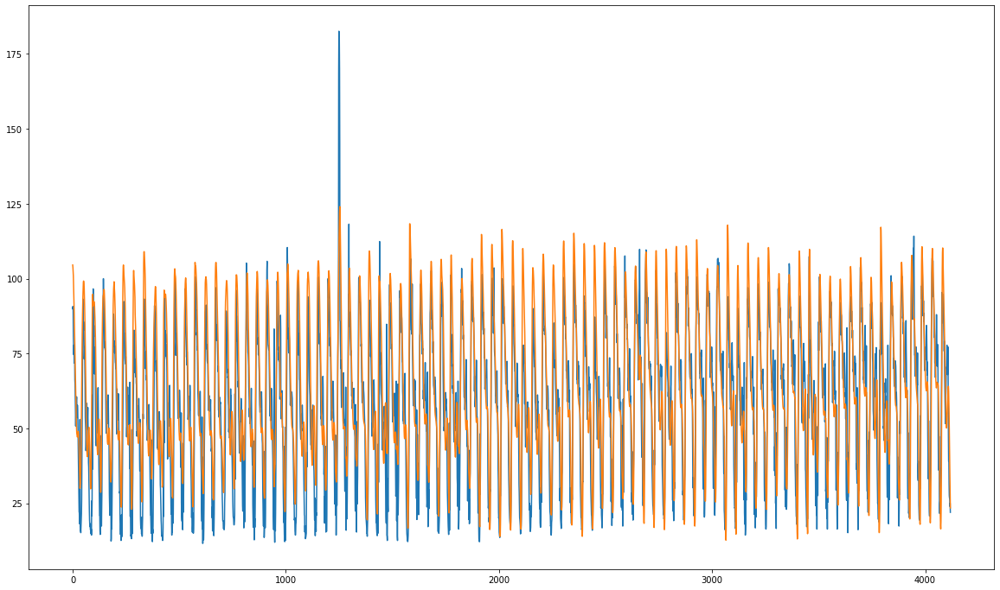

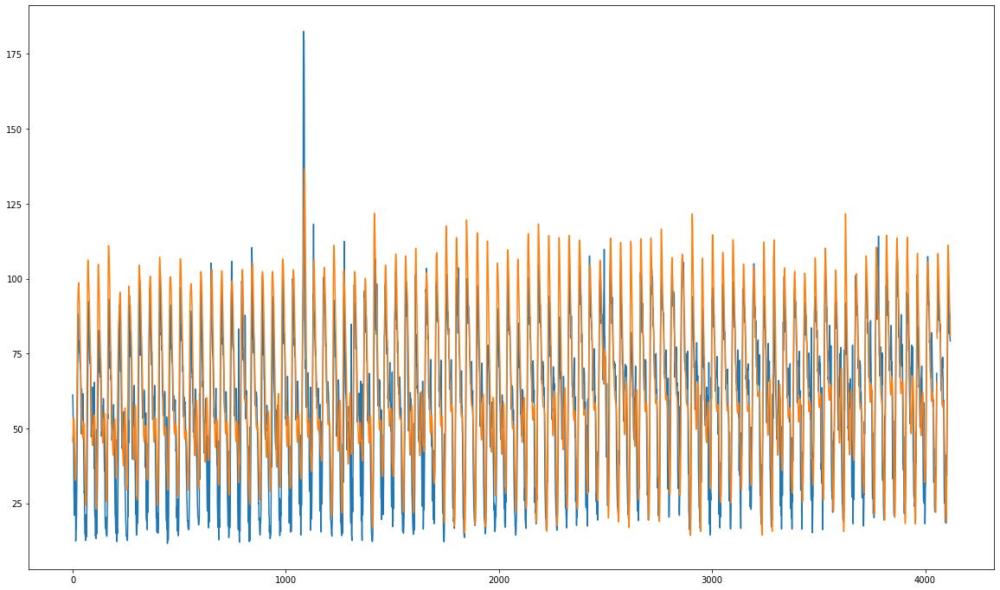

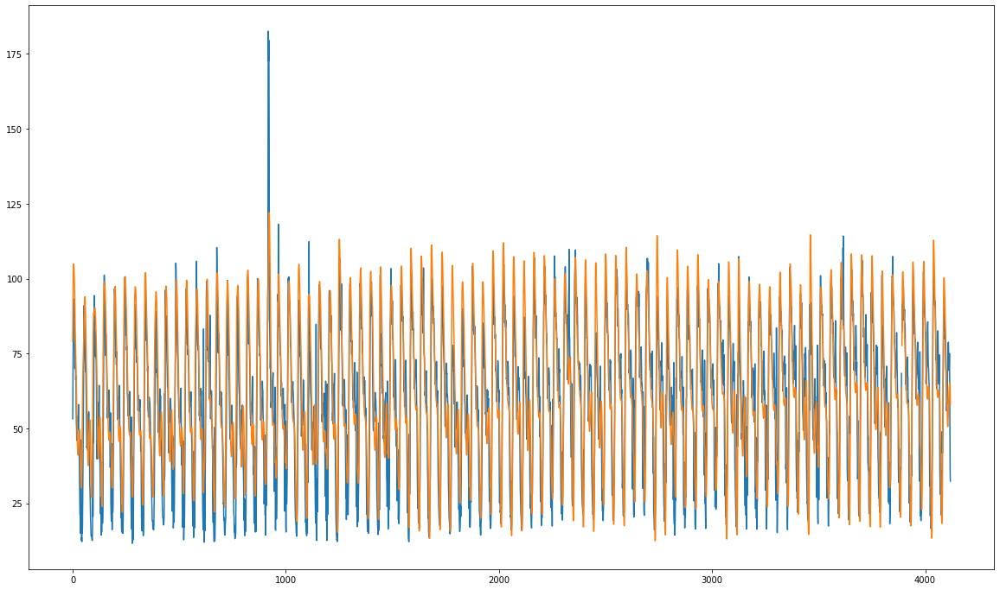

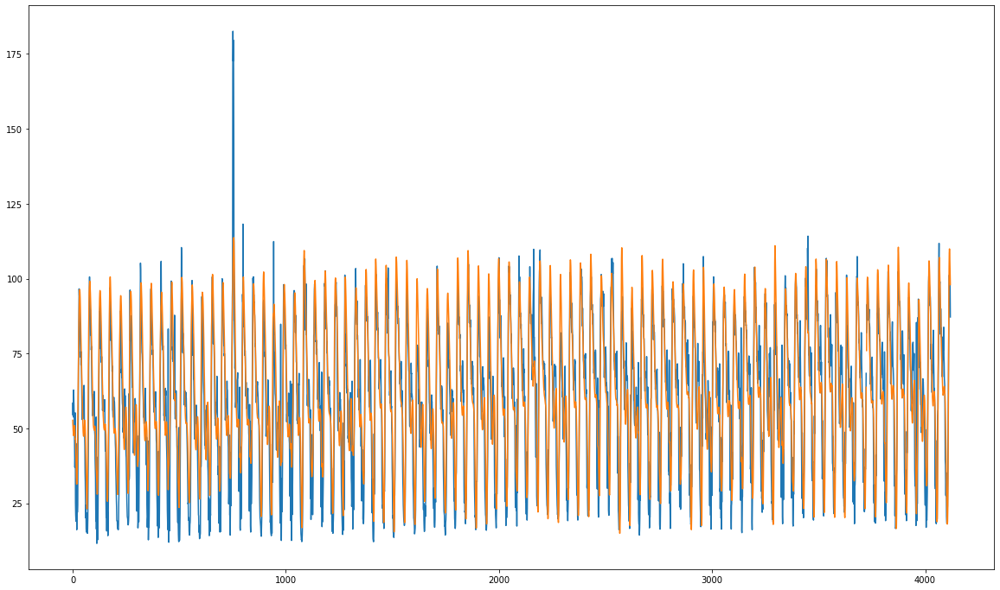

...

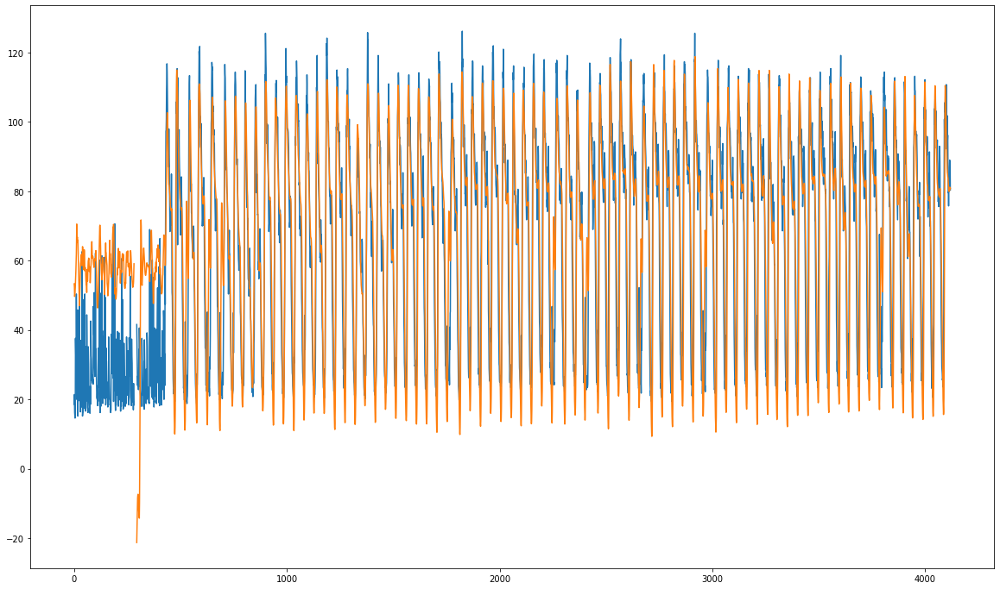

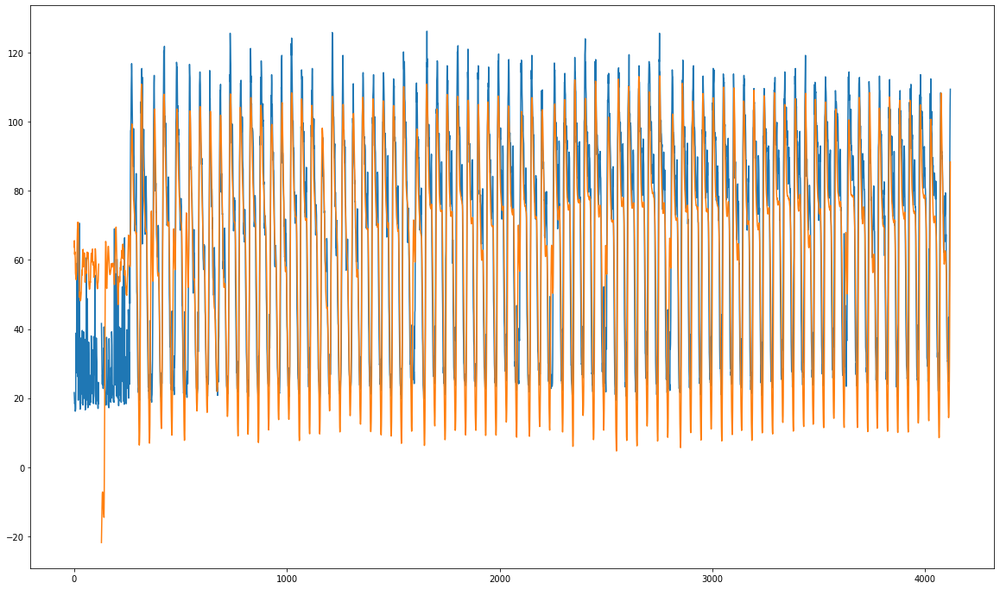

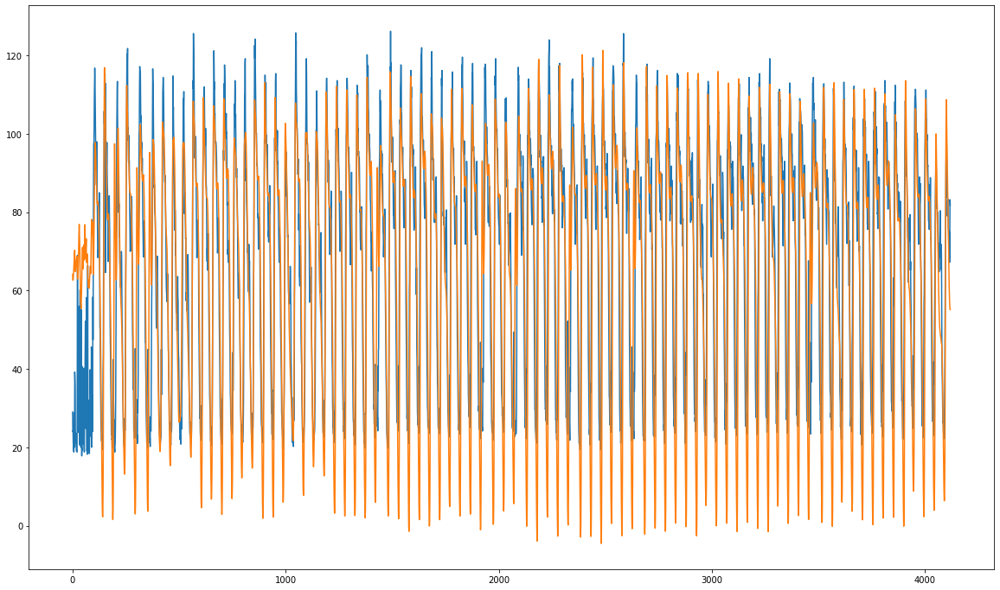

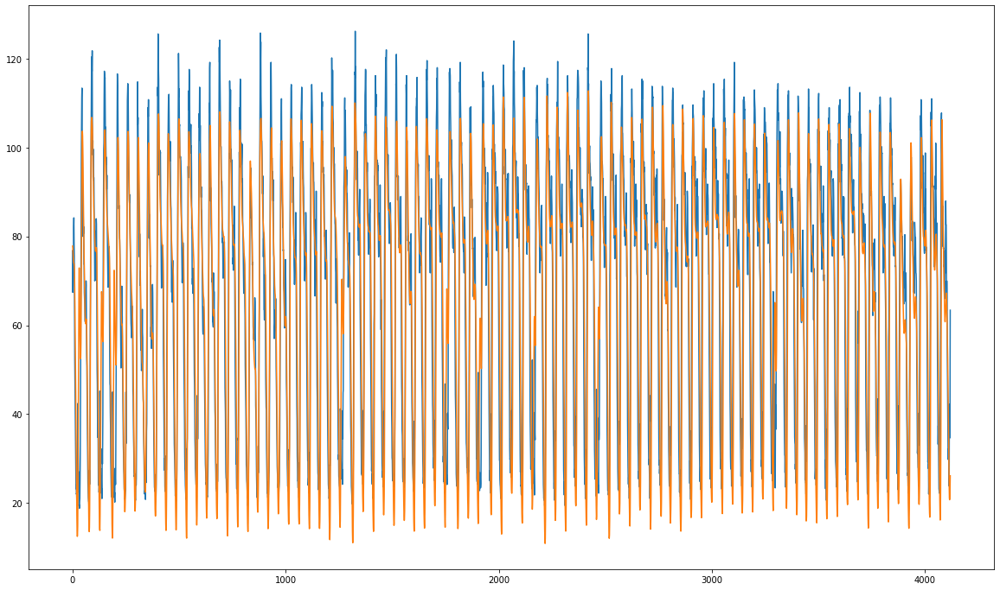

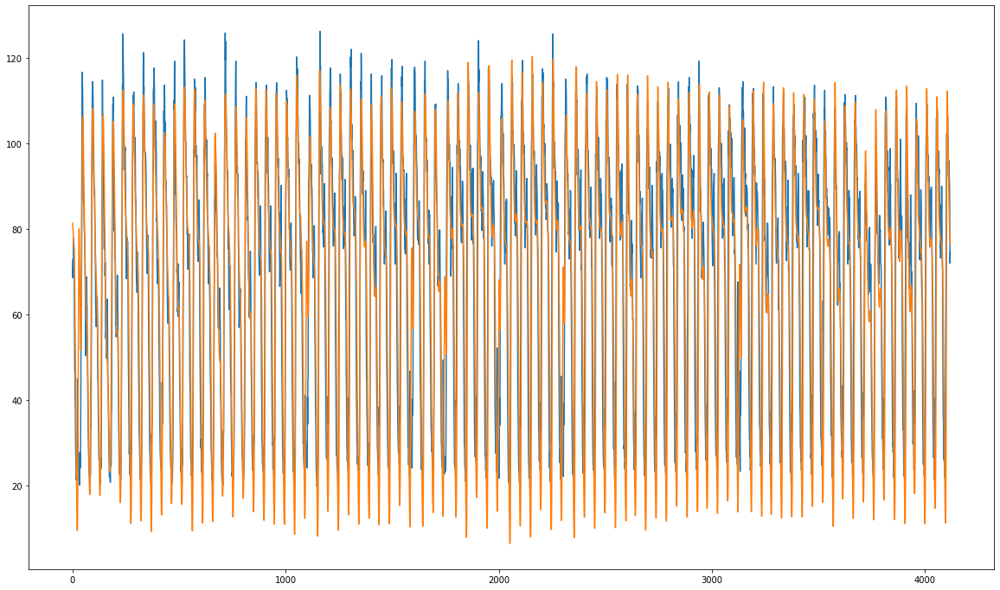

In [25]:
for i in range(0,74):
    plt.plot(inverse_scaler(Y_test[i], minX, maxX))
    plt.plot(inverse_scaler(pred_test[i][:,0], minX, maxX))
    path = "/home/costa/JoaoModelsForAlicante/PzaMont/PzaMontTestPredictions"
    plt.savefig(os.path.join(path, "PzaMontTestPrediction"+str(i)+".jpg"))
    plt.show()

In [26]:
def mse(actual, predicted):
    error = np.sum((actual-predicted)**2)/len(actual)
    return error

In [27]:
TrainErrors = []

for i in range(0, len(train_Y_data)):
    TrainErrors.append(mse(train_Y_data[i][:,0], train_predictions[i][:,0]))

Sum = 0

for i in range(0, len(TrainErrors)):
    Sum += np.sum(TrainErrors[i])
TrainMeanError = Sum/len(TrainErrors)

In [28]:
TestErrors = []

for i in range(0, len(test_Y_data)):
    TestErrors.append(mse(test_Y_data[i][:,0], test_predictions[i][:,0]))
    
for i in range(0, len(TestErrors)):
    Sum += np.sum(TestErrors[i])
TestMeanError = Sum/len(TestErrors)

In [29]:
TrainMeanError

0.00828192499716783

In [30]:
TestMeanError

0.017326999082472153

In [31]:
TrainErrors = np.array(TrainErrors)

In [32]:
TestErrors = np.array(TestErrors)

In [33]:
np.argmin(TrainErrors)

48

In [34]:
np.argmin(TestErrors)

12